In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.pyplot import figure
# from google.colab import drive
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import OrdinalEncoder
from sklearn.model_selection import KFold, train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import plot_confusion_matrix, confusion_matrix, classification_report
from sklearn import tree
%matplotlib inline
# drive.mount('/content/drive')
mpl.style.use('bmh')


# **Lectura de archivos**


In [2]:
# **Read File Credit_Record**
pd_credit_record_initial = pd.read_csv(
    "../DataSet/Tarjeta_Credito/credit_record.csv")
pd_credit_record_initial.head()


,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C


In [3]:
# Read File Application
pd_application_record_initial = pd.read_csv(
    "../DataSet/Tarjeta_Credito/application_record.csv")
pd_application_record_initial.head()


,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0


# **Exploracion datasets**


## Credit card record


In [4]:
pd_credit_record_initial.shape


(1048575, 3)

In [5]:
pd_credit_record_initial.describe()


,ID,MONTHS_BALANCE
count,1.048575e+06,1.048575e+06
mean,5.068286e+06,-1.913700e+01
std,4.615058e+04,1.402350e+01
min,5.001711e+06,-6.000000e+01
25%,5.023644e+06,-2.900000e+01
50%,5.062104e+06,-1.700000e+01
75%,5.113856e+06,-7.000000e+00
max,5.150487e+06,0.000000e+00


In [6]:
pd_credit_record_initial.dtypes


ID                 int64
MONTHS_BALANCE     int64
STATUS            object
dtype: object

In [7]:
pd_credit_record_initial.isnull().sum()


ID                0
MONTHS_BALANCE    0
STATUS            0
dtype: int64

In [8]:
%pip install https: // github.com/pandas-profiling/pandas-profiling/archive/master.zip


  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [9]:
%pip install ipywidgets


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [10]:
from pandas_profiling import ProfileReport
ProfileReport(pd_credit_record_initial, minimal=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Application record


In [11]:
pd_application_record_initial.shape


(438557, 18)

In [12]:
pd_application_record_initial.describe()


,ID,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,4.385570e+05,438557.000000,4.385570e+05,438557.000000,438557.000000,438557.0,438557.000000,438557.000000,438557.000000,438557.000000
mean,6.022176e+06,0.427390,1.875243e+05,-15997.904649,60563.675328,1.0,0.206133,0.287771,0.108207,2.194465
std,5.716370e+05,0.724882,1.100869e+05,4185.030007,138767.799647,0.0,0.404527,0.452724,0.310642,0.897207
min,5.008804e+06,0.000000,2.610000e+04,-25201.000000,-17531.000000,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.609375e+06,0.000000,1.215000e+05,-19483.000000,-3103.000000,1.0,0.000000,0.000000,0.000000,2.000000
50%,6.047745e+06,0.000000,1.607805e+05,-15630.000000,-1467.000000,1.0,0.000000,0.000000,0.000000,2.000000
75%,6.456971e+06,1.000000,2.250000e+05,-12514.000000,-371.000000,1.0,0.000000,1.000000,0.000000,3.000000
max,7.999952e+06,19.000000,6.750000e+06,-7489.000000,365243.000000,1.0,1.000000,1.000000,1.000000,20.000000


In [13]:
pd_application_record_initial.dtypes


ID                       int64
CODE_GENDER             object
FLAG_OWN_CAR            object
FLAG_OWN_REALTY         object
CNT_CHILDREN             int64
AMT_INCOME_TOTAL       float64
NAME_INCOME_TYPE        object
NAME_EDUCATION_TYPE     object
NAME_FAMILY_STATUS      object
NAME_HOUSING_TYPE       object
DAYS_BIRTH               int64
DAYS_EMPLOYED            int64
FLAG_MOBIL               int64
FLAG_WORK_PHONE          int64
FLAG_PHONE               int64
FLAG_EMAIL               int64
OCCUPATION_TYPE         object
CNT_FAM_MEMBERS        float64
dtype: object

In [14]:
pd_application_record_initial.isnull().sum()


ID                          0
CODE_GENDER                 0
FLAG_OWN_CAR                0
FLAG_OWN_REALTY             0
CNT_CHILDREN                0
AMT_INCOME_TOTAL            0
NAME_INCOME_TYPE            0
NAME_EDUCATION_TYPE         0
NAME_FAMILY_STATUS          0
NAME_HOUSING_TYPE           0
DAYS_BIRTH                  0
DAYS_EMPLOYED               0
FLAG_MOBIL                  0
FLAG_WORK_PHONE             0
FLAG_PHONE                  0
FLAG_EMAIL                  0
OCCUPATION_TYPE        134203
CNT_FAM_MEMBERS             0
dtype: int64

In [15]:
! pip install https: // github.com/pandas-profiling/pandas-profiling/archive/master.zip


ERROR: Directory '//' is not installable. Neither 'setup.py' nor 'pyproject.toml' found.

[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [16]:
from pandas_profiling import ProfileReport
ProfileReport(pd_application_record_initial, minimal=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#**Limpieza de datos**


In [17]:
pd_credit_record = pd_credit_record_initial.drop_duplicates(subset=['ID'])
pd_application_record = pd_application_record_initial.drop_duplicates(subset=[
                                                                      'ID'])
print(pd_credit_record.shape)
print(pd_application_record.shape)


(45985, 3)
(438510, 18)


## Credit card record


### Cuales son los clientes que estuvieron en mora mayores o iguales a 60 días en los ultimos 5 años?


In [18]:
print("Numero de clientes en el record de trajetas de credito: {}".format(
    len(pd_credit_record_initial.ID.unique())))
# para verificar si tenemos alguna data perdida
pd_credit_record_charge_off_rate = pd_credit_record_initial.copy()
pd_credit_record_drop = pd_credit_record_charge_off_rate.dropna()
if pd_credit_record_charge_off_rate.shape == pd_credit_record_drop.shape:
    print("No hay data perdida.")
else:
    print("Tenemos {} filas  con data perdida".format(len(
        pd_credit_record_charge_off_rate.ID.unique())-len(pd_credit_record_drop.ID.unique())))


Numero de clientes en el record de trajetas de credito: 45985
No hay data perdida.


In [19]:
# Agrupnado por ID`s
# pd_credit_record_charge_off_rate.sort_values('ID')

# Verificando duplicados
groups_month = pd_credit_record_charge_off_rate.groupby(
    ['ID', 'MONTHS_BALANCE'])
groups_month_count = groups_month.count()
groups_month_count = groups_month_count.rename(columns={"STATUS": "COUNT"})
if groups_month_count.loc[groups_month_count['COUNT'] > 1].empty:
    print("No hay duplicados")
else:
    print("Hay duplicados")


No hay duplicados


In [20]:
# reshape data by 'ID' based on 'MONTHS_BALANCE'
credit_pivot = pd_credit_record_charge_off_rate.pivot(
    index='ID', columns='MONTHS_BALANCE', values='STATUS')
print(credit_pivot.head())


MONTHS_BALANCE  -60  -59  -58  -57  -56  -55  -54  -53  -52  -51  ...  -9   \
ID                                                                ...        
5001711         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...  NaN   
5001712         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...    0   
5001713         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...    X   
5001714         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...    X   
5001715         NaN    X    X    X    X    X    X    X    X    X  ...    X   

MONTHS_BALANCE  -8   -7   -6   -5   -4  -3  -2  -1   0   
ID                                                       
5001711         NaN  NaN  NaN  NaN  NaN   0   0   0   X  
5001712           C    C    C    C    C   C   C   C   C  
5001713           X    X    X    X    X   X   X   X   X  
5001714           X    X    X    X    X   X   X   X   X  
5001715           X    X    X    X    X   X   X   X   X  

[5 rows x 61 columns]


In [21]:
# Asumimos que el ultimo mes esta abierto para realizar pago
# Asumimos que el primer mes esta cerrado para realizar pago
# group pd_credit_record_charge_off_rate  por 'ID' e identificamos el ultimo y el primer mes.
credit_grouped = pd_credit_record_charge_off_rate.groupby('ID')
credit_pivot['open_month'] = credit_grouped['MONTHS_BALANCE'].min()
credit_pivot['close_month'] = credit_grouped['MONTHS_BALANCE'].max()
credit_pivot['ID'] = credit_pivot.index
credit_pivot = credit_pivot[['ID', 'open_month', 'close_month']]
credit_pivot.reset_index(drop=True, inplace=True)
credit_pivot["window_month"] = credit_pivot['close_month'] - \
    credit_pivot['open_month']
# merge ambos df
credit = pd.merge(pd_credit_record_charge_off_rate,
                  credit_pivot, how='left', on='ID')
# Meses en el balance
credit['MOB'] = credit['MONTHS_BALANCE']-credit['open_month']
credit.sort_values(['ID', 'MOB'], inplace=True)

# Divido por 48 para llevarlo a 4 years
bins = [k for k in range(-61, 1, 12)]
credit['open_year'] = pd.cut(
    credit['open_month'], bins, labels=[-5, -4, -3, -2, -1])  # open_year_to_today

credit.head()


,ID,MONTHS_BALANCE,STATUS,open_month,close_month,window_month,MOB,open_year
3,5001711,-3,0,-3,0,3,0,-1
2,5001711,-2,0,-3,0,3,1,-1
1,5001711,-1,0,-3,0,3,2,-1
0,5001711,0,X,-3,0,3,3,-1
22,5001712,-18,0,-18,0,18,0,-2


In [22]:
credit.groupby(["STATUS"])["STATUS"].count()


STATUS
0    383120
1     11090
2       868
3       320
4       223
5      1693
C    442031
X    209230
Name: STATUS, dtype: int64

In [23]:

# un cliente sera considerado como "malo" 'bad' (1) si ha tenido mora mayores o iguales 60 dias en los ultimos cinco años
credit['overdue'] = np.where((credit['STATUS'] == '1') | (credit['STATUS'] == '2') | (
    credit['STATUS'] == '3') | (credit['STATUS'] == '4') | (credit['STATUS'] == '5'), 1, 0)

df_mask = credit['overdue'] == 1

Bad_cliente_df = credit[df_mask]
Bad_cliente_df.drop_duplicates(subset=['ID'])


,ID,MONTHS_BALANCE,STATUS,open_month,close_month,window_month,MOB,open_year,overdue
154,5001718,-12,1,-38,0,38,26,-4,1
239,5001720,-15,1,-35,0,35,20,-3,1
918,5001757,-3,1,-20,0,20,17,-2,1
1490,5001786,-38,1,-58,0,58,20,-5,1
1630,5001792,-8,1,-24,0,24,16,-2,1
...,...,...,...,...,...,...,...,...,...
1047846,5150412,-9,1,-17,0,17,8,-2,1
1047963,5150417,-30,1,-37,-11,26,7,-4,1
1048173,5150459,-43,1,-51,0,51,8,-5,1
1048223,5150463,-2,1,-10,0,10,8,-1,1


In [24]:
Bad_cliente_df


,ID,MONTHS_BALANCE,STATUS,open_month,close_month,window_month,MOB,open_year,overdue
154,5001718,-12,1,-38,0,38,26,-4,1
150,5001718,-8,1,-38,0,38,30,-4,1
239,5001720,-15,1,-35,0,35,20,-3,1
237,5001720,-13,1,-35,0,35,22,-3,1
231,5001720,-7,1,-35,0,35,28,-3,1
...,...,...,...,...,...,...,...,...,...
1048245,5150464,-13,1,-21,0,21,8,-2,1
1048244,5150464,-12,1,-21,0,21,9,-2,1
1048243,5150464,-11,1,-21,0,21,10,-2,1
1048242,5150464,-10,1,-21,0,21,11,-2,1


In [25]:
credit.groupby(["overdue"])["overdue"].count()


overdue
0    1034381
1      14194
Name: overdue, dtype: int64

In [26]:
# N = len(pd_credit_record)

# for i in range(N):
#     if pd_credit_record.iloc[i, 0] in Bad_cliente_df.ID.values:
#         pd_credit_record.iloc[i, 2] = 1
#     else:
#         pd_credit_record.iloc[i, 2] = 0


In [27]:
pd_credit_record.head()


,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
4,5001712,0,C
23,5001713,0,X
45,5001714,0,X
60,5001715,0,X


In [28]:
# pd_credit_record['STATUS'] = np.where((pd_credit_record['STATUS'] == '1') | (pd_credit_record['STATUS'] == '2') | (
#     pd_credit_record['STATUS'] == '3') | (pd_credit_record['STATUS'] == '4') | (pd_credit_record['STATUS'] == '5'), 1, 0)


In [29]:
pd_credit_record.groupby(["STATUS"])["STATUS"].count()


STATUS
0    10547
1      353
2       19
3        6
4        5
5       82
C    22707
X    12266
Name: STATUS, dtype: int64

In [30]:
merge_record = pd.merge(pd_credit_record, pd_application_record, on=["ID"])
merge_record.sort_values("ID", inplace=True)
merge_record['DAYS_BIRTH'] = merge_record['DAYS_BIRTH']/-365
merge_record.rename(columns={'DAYS_BIRTH': "AGE"}, inplace=True)

merge_record['DAYS_EMPLOYED'] = merge_record['DAYS_EMPLOYED']/-365
merge_record.rename(columns={'DAYS_EMPLOYED': "YEARS_EMPLOYED"}, inplace=True)

merge_record.head()


,ID,MONTHS_BALANCE,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,0,C,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32.890411,12.443836,1,1,0,0,NaN,2.0
1,5008805,0,C,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32.890411,12.443836,1,1,0,0,NaN,2.0
2,5008806,0,C,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2.0
3,5008808,0,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1.0
4,5008809,-22,X,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1.0


In [31]:
merge_record.groupby(["STATUS"])["STATUS"].count()


STATUS
0     8456
1      276
2       19
3        6
4        5
5       76
C    17950
X     9669
Name: STATUS, dtype: int64

In [32]:
# merge_record_reserva = merge_record.copy()
# merge_record_test = merge_record.copy()
def status(s):
    if s == "C" or s == "X":
        return 0  # si aprueba tarjeta credito
    else:
        return 1  # no se aprueba tarjeta credito


merge_record['STATUS'] = merge_record['STATUS'].apply(lambda x: status(x))
# merge_record["STATUS"] = np.where((merge_record["STATUS"] == "C" OR  merge_record["STATUS"] == "X"), 0, 1)
merge_record = merge_record.astype({"CNT_FAM_MEMBERS": "int"})


In [33]:
merge_record.groupby(["STATUS"])["STATUS"].count()


STATUS
0    27619
1     8838
Name: STATUS, dtype: int64

In [34]:
merge_record.shape


(36457, 20)

In [35]:
merge_record.describe()


,ID,MONTHS_BALANCE,STATUS,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,3.645700e+04,36457.000000,36457.000000,36457.000000,3.645700e+04,36457.000000,36457.000000,36457.0,36457.000000,36457.000000,36457.000000,36457.000000
mean,5.078227e+06,-5.831802,0.242423,0.430315,1.866857e+05,43.767598,-162.364207,1.0,0.225526,0.294813,0.089722,2.198453
std,4.187524e+04,11.326494,0.428554,0.742367,1.017892e+05,11.508356,377.126945,0.0,0.417934,0.455965,0.285787,0.911686
min,5.008804e+06,-60.000000,0.000000,0.000000,2.700000e+04,20.517808,-1000.665753,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.042028e+06,-6.000000,0.000000,0.000000,1.215000e+05,34.142466,1.117808,1.0,0.000000,0.000000,0.000000,2.000000
50%,5.074614e+06,0.000000,0.000000,0.000000,1.575000e+05,42.638356,4.252055,1.0,0.000000,0.000000,0.000000,2.000000
75%,5.115396e+06,0.000000,0.000000,1.000000,2.250000e+05,53.254795,8.638356,1.0,0.000000,1.000000,0.000000,3.000000
max,5.150487e+06,0.000000,1.000000,19.000000,1.575000e+06,68.909589,43.049315,1.0,1.000000,1.000000,1.000000,20.000000


# **Reducción de la dimensionalidad del dataset**


## Identificando Outliers


In [36]:
l = [x for x in merge_record.columns if x not in ["ID", "MONTHS_BALANCE",	"STATUS", "CODE_GENDER", "FLAG_OWN_CAR", "FLAG_OWN_REALTY", "DAYS_EMPLOYED", "NAME_INCOME_TYPE",
                                                  "NAME_EDUCATION_TYPE",	"NAME_FAMILY_STATUS",	"NAME_HOUSING_TYPE", "FLAG_MOBIL", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_EMAIL", "OCCUPATION_TYPE", "CNT_FAM_MEMBERS"]]
agg_merge_record = merge_record[l]
agg_merge_record


,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED
0,0,427500.0,32.890411,12.443836
1,0,427500.0,32.890411,12.443836
2,0,112500.0,58.832877,3.106849
3,0,270000.0,52.356164,8.358904
4,0,270000.0,52.356164,8.358904
...,...,...,...,...
36452,1,157500.0,29.610959,4.764384
36453,1,157500.0,29.610959,4.764384
36454,1,157500.0,29.610959,4.764384
36455,1,157500.0,29.610959,4.764384


In [37]:
for i, j in zip(range(3), agg_merge_record.columns):
    fig = px.box(agg_merge_record.columns, x=agg_merge_record[j], title=str(
        agg_merge_record[j].name), height=400)
    fig.show()


In [38]:
def outliers(df, ft):
    Q1 = df[ft].quantile(0.25)
    Q3 = df[ft].quantile(0.75)
    IQR = Q3 - Q1

    frontera_inferior = Q1 - 1.5*IQR
    frontera_superior = Q3 + 1.5*IQR

    ls = df.index[(df[ft] < frontera_inferior) | (df[ft] > frontera_superior)]

    return ls


In [39]:
index_list = []
for column in ["AMT_INCOME_TOTAL", "AGE", "CNT_CHILDREN", "YEARS_EMPLOYED"]:
    index_list.extend(outliers(agg_merge_record, column))

print("Se identiticaron ", len(index_list), "Outliers")


Se identiticaron  9942 Outliers


## Removiendo Outliers


In [40]:
def remover_outliers(df, ls):
    ls = sorted(set(ls))
    df = df.drop(ls)
    return df


In [41]:
merge_cleaned = remover_outliers(merge_record, index_list)
merge_cleaned


,ID,MONTHS_BALANCE,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,5008806,0,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2
3,5008808,0,1,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
4,5008809,-22,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
5,5008810,0,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
6,5008811,0,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36452,5150482,-11,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36453,5150483,0,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36454,5150484,0,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36455,5150485,0,1,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3


In [42]:
l = [x for x in merge_cleaned.columns if x not in ["ID", "MONTHS_BALANCE",	"STATUS", "CODE_GENDER", "FLAG_OWN_CAR", "FLAG_OWN_REALTY", "DAYS_EMPLOYED", "NAME_INCOME_TYPE",
                                                   "NAME_EDUCATION_TYPE",	"NAME_FAMILY_STATUS",	"NAME_HOUSING_TYPE", "FLAG_MOBIL", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_EMAIL", "OCCUPATION_TYPE", "CNT_FAM_MEMBERS"]]
agg_merge_record_test = merge_cleaned[l]
agg_merge_record_test


,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED
2,0,112500.0,58.832877,3.106849
3,0,270000.0,52.356164,8.358904
4,0,270000.0,52.356164,8.358904
5,0,270000.0,52.356164,8.358904
6,0,270000.0,52.356164,8.358904
...,...,...,...,...
36452,1,157500.0,29.610959,4.764384
36453,1,157500.0,29.610959,4.764384
36454,1,157500.0,29.610959,4.764384
36455,1,157500.0,29.610959,4.764384


In [43]:
# plt.figure(figsize=(13,11))
for i, j in zip(range(3), agg_merge_record_test):
    fig = px.box(agg_merge_record_test, x=agg_merge_record_test[j], title=str(
        agg_merge_record_test[j].name), height=400)
    fig.show()
    # plt.subplot(4,2,i+1)
    # sns.boxplot(x=agg_merge_record_test[j])
    # plt.title(j)
    # plt.xlabel('')


Debido a la poca variabilidad de los datos en la cantidad de hijos (mayormente 0 o 1), se genera una division importante en el arbol de decisiones ya que son 2 extremos que hacen una gran diferencia en la economia de un cliente.


In [44]:
merge_cleaned.drop(
    ["MONTHS_BALANCE"], axis=1, inplace=True)
merge_cleaned['STATUS'] = merge_cleaned['STATUS'].astype('int64')
merge_cleaned.head()


,ID,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,5008806,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2
3,5008808,1,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
4,5008809,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
5,5008810,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
6,5008811,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1


In [45]:
merge_cleaned.dtypes


ID                       int64
STATUS                   int64
CODE_GENDER             object
FLAG_OWN_CAR            object
FLAG_OWN_REALTY         object
CNT_CHILDREN             int64
AMT_INCOME_TOTAL       float64
NAME_INCOME_TYPE        object
NAME_EDUCATION_TYPE     object
NAME_FAMILY_STATUS      object
NAME_HOUSING_TYPE       object
AGE                    float64
YEARS_EMPLOYED         float64
FLAG_MOBIL               int64
FLAG_WORK_PHONE          int64
FLAG_PHONE               int64
FLAG_EMAIL               int64
OCCUPATION_TYPE         object
CNT_FAM_MEMBERS          int32
dtype: object

## Verificar tamaño


In [46]:
merge_cleaned["STATUS"].value_counts()


0    20238
1     6465
Name: STATUS, dtype: int64

En base a esta información es posible verificar que existe una diferencia de 7.5 entre la cantidad de muestra entre el estatus 0 y el 1.
Esto es necesario considerar porque se generará un peso de esta diferencia para la clase 1 en el arbol de decision.


# **Obtención de insights**


##Análisis Univariado


In [47]:
Num_variables = ["CNT_CHILDREN", "AMT_INCOME_TOTAL",
                 "AGE",	"YEARS_EMPLOYED", "CNT_FAM_MEMBERS"]


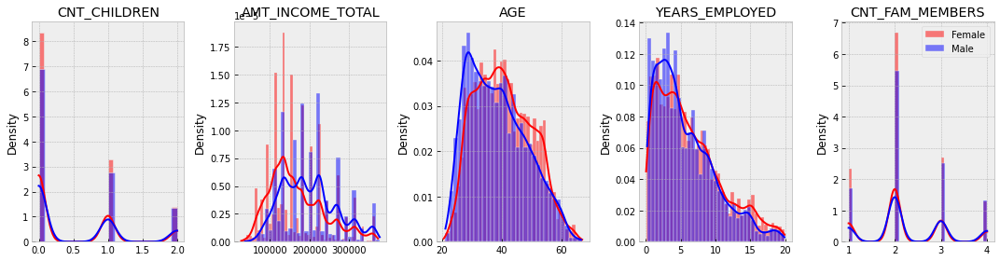

In [48]:
columns = 5
fig, axes = plt.subplots(len(Num_variables) // columns,
                         columns, squeeze=False, figsize=(15, 4))

F = merge_cleaned[merge_cleaned['CODE_GENDER'] == "F"]
M = merge_cleaned[merge_cleaned['CODE_GENDER'] == "M"]

for current_idx, variable in enumerate(Num_variables):
    i = current_idx // columns  # Filas
    j = current_idx % columns  # Columnas

    sns.histplot(F[variable], label='Female', ax=axes[i]
                 [j], stat="density", color="red", kde=True)
    sns.histplot(M[variable], label='Male', ax=axes[i]
                 [j], stat="density", color="blue", kde=True)

    axes[i][j].set_title(variable)
    axes[i][j].set_xlabel("")

plt.tight_layout()
plt.legend()
plt.show()


### Tiene impacto en la aprobación de TDC el nivel academico de los solicitantes?


In [49]:
record_approved = merge_cleaned["STATUS"] == 0
merge_record_approved = merge_cleaned[record_approved]
merge_record_approved


,ID,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,5008806,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2
4,5008809,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
5,5008810,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
6,5008811,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
11,5008819,0,M,Y,Y,0,135000.0,Commercial associate,Secondary / secondary special,Married,House / apartment,48.706849,3.271233,1,0,0,0,Laborers,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36451,5150481,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36452,5150482,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36453,5150483,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3
36454,5150484,0,F,Y,Y,1,157500.0,Working,Secondary / secondary special,Married,House / apartment,29.610959,4.764384,1,0,0,0,Core staff,3


In [50]:
# Dataframe record_EDUCATION_TOTAL
pd_application_record_EDUCATION = merge_cleaned.groupby(
    ["NAME_EDUCATION_TYPE"]).size().reset_index(name="COUNT")
pd_application_record_EDUCATION_percentage = pd_application_record_EDUCATION.assign(
    PERCETANGE=pd_application_record_EDUCATION[["COUNT"]] / len(merge_record)*100)
pd_application_record_EDUCATION_percentage


,NAME_EDUCATION_TYPE,COUNT,PERCETANGE
0,Academic degree,28,0.076803
1,Higher education,7548,20.703843
2,Incomplete higher,1220,3.346408
3,Lower secondary,209,0.573278
4,Secondary / secondary special,17698,48.544861


In [51]:
# Dataframe record_EDUCATION_APPROVED
pd_application_record_EDUCATION_APPROVED = merge_record_approved.groupby(
    ["NAME_EDUCATION_TYPE"]).size().reset_index(name="COUNT")
pd_application_record_EDUCATION_APPROVED_percentage = pd_application_record_EDUCATION_APPROVED.assign(
    PERCETANGE=pd_application_record_EDUCATION_APPROVED[["COUNT"]] / len(merge_record_approved)*100)
pd_application_record_EDUCATION_APPROVED_percentage


,NAME_EDUCATION_TYPE,COUNT,PERCETANGE
0,Academic degree,26,0.128471
1,Higher education,5815,28.733076
2,Incomplete higher,914,4.516257
3,Lower secondary,165,0.815298
4,Secondary / secondary special,13318,65.806898


In [52]:
# Subplot comparando Solicitados vs aprobados
fig = make_subplots(rows=1, cols=2, specs=[
                    [{'type': 'domain'}, {'type': 'domain'}]])

labels = list(
    pd_application_record_EDUCATION_percentage["NAME_EDUCATION_TYPE"])

fig.add_trace(go.Pie(labels=labels, values=list(
    pd_application_record_EDUCATION_percentage["COUNT"]), pull=[0.2, 0.2, 0.2, 0.2]), 1, 1)

fig.add_trace(go.Pie(labels=labels, values=list(pd_application_record_EDUCATION_APPROVED_percentage["COUNT"]),  pull=[0.2, 0.2, 0.2, 0.2]),
              1, 2)

# Creando grafico tipo dona
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="Nivel academico",
    # Sumando anotaciones
    annotations=[dict(text='Solicitantes', x=0.17, y=0.5, font_size=15, showarrow=False),
                 dict(text='Aprobados', x=0.83, y=0.5, font_size=15, showarrow=False)])


fig.show()


**Interpretación de los resultados**

Con respecto al total de los solicitantes y de quienes recibieron una tarjeta de credito, se observa que mas de la mitad cuentan con la secundaria completa y mas de un cuarto cuenta con educaciòn superior culminada. Con lo cual mas del 95% cuentan nivel educativo alto o medio y no se observa incidencia del nivel educativo en el otorgamiento de dicha tarjeta. Dado que se mantiene las proporciones en ambas poblaciones. Con lo cual se demuestra que esta variable no impacta la aprobación de la TDC.


## Análisis Bivariado


<Figure size 432x288 with 0 Axes>

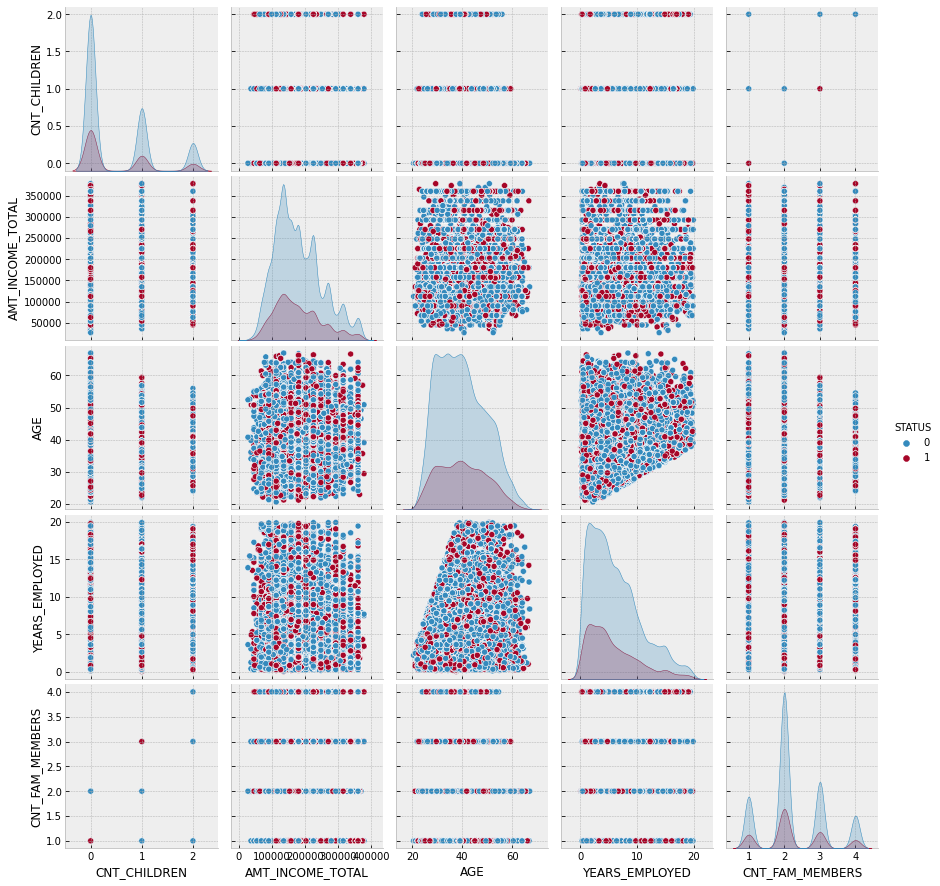

In [53]:
plt.figure()
Num_Gen_var = Num_variables.copy()
Num_Gen_var.append('STATUS')

sns.pairplot(merge_cleaned[Num_Gen_var], hue='STATUS',
             hue_order=[0, 1])  # ,palette = 'plasma')

plt.show()


### ¿Cual es la correlacion entre el estado civil de los clientes y la tasa de aprovacion de tarjetas de credito?


In [54]:
status_Family_Status_Join = pd.concat([merge_cleaned["NAME_FAMILY_STATUS"], merge_record["STATUS"]],
                                      axis=1)
countRows = status_Family_Status_Join.shape[0]
status_Family_Status_Join.index = np.arange(countRows)

mapped = status_Family_Status_Join.groupby(
    ["NAME_FAMILY_STATUS", "STATUS"]).size().reset_index(name="COUNT")
mapped.head()


,NAME_FAMILY_STATUS,STATUS,COUNT
0,Civil marriage,0,1857
1,Civil marriage,1,518
2,Married,0,13971
3,Married,1,4519
4,Separated,0,1150


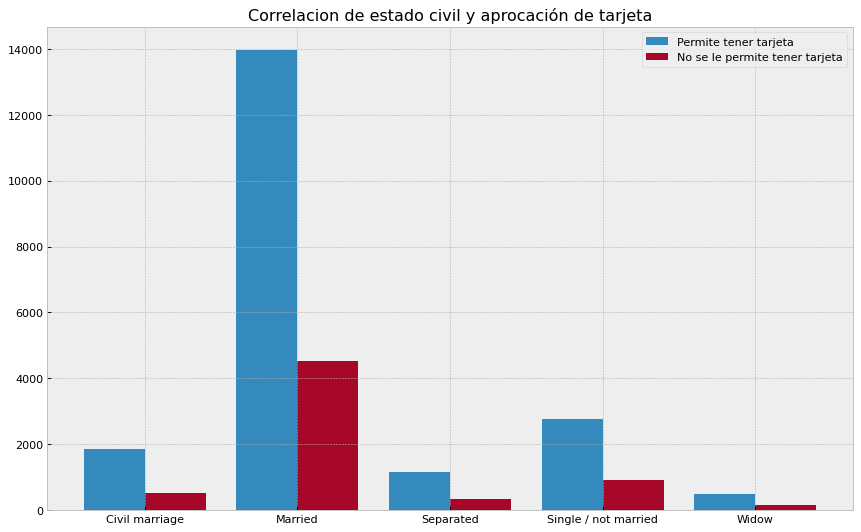

In [55]:
mappped_Pivoted = mapped.pivot(
    index="STATUS", columns="NAME_FAMILY_STATUS", values="COUNT")

status0 = []
status1 = []
columnsValues = mappped_Pivoted.columns.values
figure(figsize=(13, 8), dpi=80)

for valueSts in columnsValues:
    status0.append(mappped_Pivoted[valueSts][0])
    status1.append(mappped_Pivoted[valueSts][1])

x_axis = np.arange(len(columnsValues))

# Multi bar Chart

plt.bar(x_axis - 0.2, status0, width=0.4, label='Permite tener tarjeta')
plt.bar(x_axis + 0.2, status1, width=0.4,
        label='No se le permite tener tarjeta')

plt.xticks(x_axis, columnsValues)

# Add legend
plt.legend()

# Add title
plt.title("Correlacion de estado civil y aprocación de tarjeta")

# Modify Font
plt.rcParams.update({'font.size': 8})

# Display
plt.show()


**Interpretación de los resultados**

De este gráfico es posible interpretar que existe una gran afluencia de las personas que están casadas y que desean poseer una tarjeta de crédito; pero además no es posible concluir que existe alguna tendencia respecto al estado cívil de las personas que indique que se le otorgará con mayor probabilidad su tarjeta de crédito.


###¿Cual es la distribucion de las edades de los clientes que solicitan tarjetas de credito?


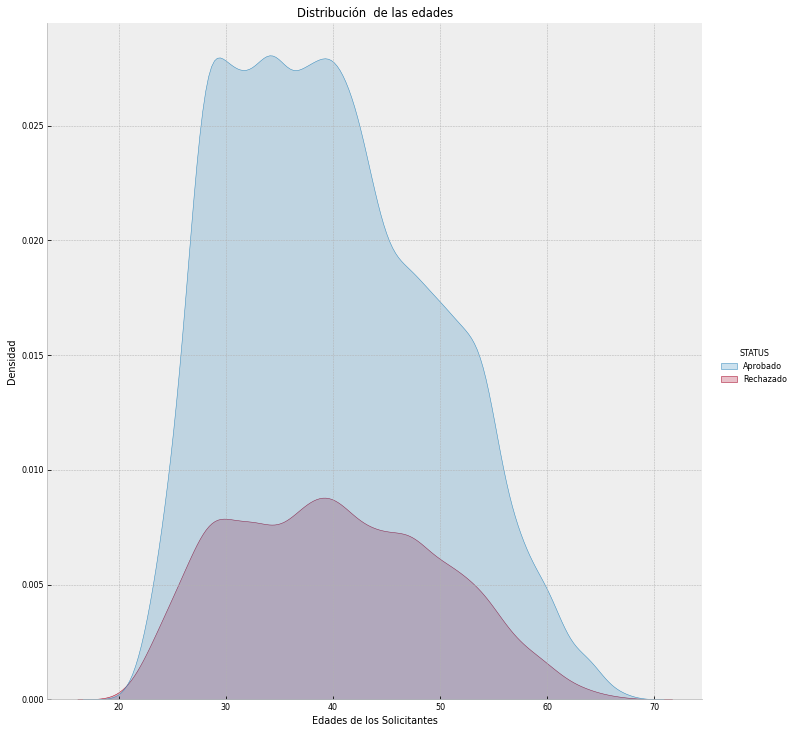

In [56]:
# Distribución de edad
merge_record_change_value_status = merge_cleaned.copy()
merge_record_change_value_status["STATUS"] = np.where(
    merge_record_change_value_status["STATUS"] == 0, "Aprobado", "Rechazado")
ax = sns.displot(data=merge_record_change_value_status, x='AGE',
                 kind='kde', hue='STATUS', fill=True, height=10)
ax.set(xlabel='Edades de los Solicitantes',
       ylabel='Densidad', title='Distribución  de las edades')


**Interpretación de los resultados**

La distribución de los aprobados es del tipo leptokurtica con inclinación negativa. En la misma se observa un pico entre la edades de 35 y 45 años. Por otro lado la distribución de los rechazados es del tipo mesokurtica. En conclusión la edad es un factor que indice en la aprobación de las TDC, siendo los mas jovenes quienes cuentan con mayor tasa de aprobación.


###¿cuales edades y sexos presentan mayores ingresos?


In [57]:
fig = px.histogram(merge_cleaned, x="AGE", y="AMT_INCOME_TOTAL", color="CODE_GENDER", marginal="box",
                   hover_data=merge_cleaned.columns)
fig.show()


**Interpretación de los resultados**

En general el nivel de ingreso de las mujeres es mayor que los hombres y en ambos sexos dicho nivel disminuye a medida que avanza la edad. Lo cual se relaciona con el grafico anterior, donde los mas jovenes cuentan con una mayor tasa de aprobacion.


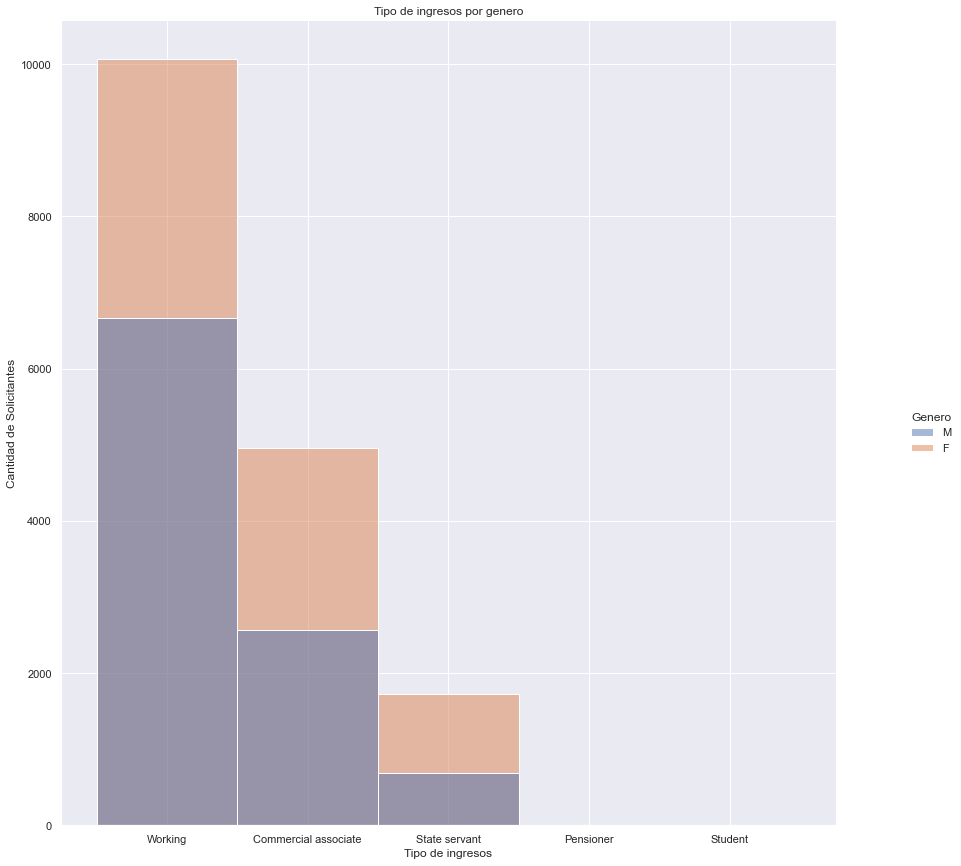

In [58]:
#  Grafico de ingresos
sns.set(font_scale=1)
ax = sns.displot(data=merge_cleaned, x="NAME_INCOME_TYPE",
                 hue="CODE_GENDER", height=12)
ax.set(xlabel='Tipo de ingresos', ylabel='Cantidad de Solicitantes',
       title="Tipo de ingresos por genero")
ax.legend.set_title("Genero")


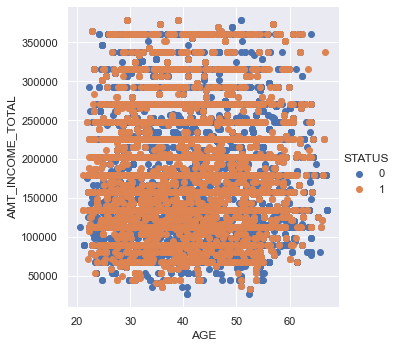

In [59]:
sns.FacetGrid(merge_cleaned, hue='STATUS', height=5).map(
    plt.scatter, 'AGE', 'AMT_INCOME_TOTAL').add_legend()
plt.show()


## Analisis Multivariado


### 1 - ¿Cuál es el nivel de correlación entre las variables?


Se procede a borrar datos con lo que no se trabajará


In [60]:
corr_merge_record = merge_cleaned.copy()
corr_merge_record.drop(["ID"], axis=1, inplace=True)
corr_merge_record.head()


,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2
3,1,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
4,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
5,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1
6,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1


### Normalizando


Se comenzarrá a verificar la correlación que existe entre las variables, para esto será necesario normalizar la información respecto a un valor número, con la idea que los valores categoricos, puedan ser numéricos.


In [61]:
def changeNameEducation(e):
    if e == "Higher education":
        return 0
    elif e == "Secondary / secondary special":
        return 1
    elif e == 'Incomplete higher':
        return 2
    elif e == 'Lower secondary':
        return 3
    elif e == 'Academic degree':
        return 4
    else:
        return 5


def changeNameIncomeType(e):
    if e == "Working":
        return 0
    elif e == "Commercial associate":
        return 1
    elif e == 'Pensioner':
        return 2
    elif e == 'State servant':
        return 3
    else:
        return 4


def changFamilyStatus(e):
    if e == "Civil marriage":
        return 0
    elif e == "Married":
        return 1
    elif e == 'Single / not married':
        return 2
    elif e == 'Separated':
        return 3
    elif e == 'Widow':
        return 4
    else:
        return 5


def changHousingType(e):
    if e == "Rented apartment":
        return 0
    elif e == "House / apartment":
        return 1
    elif e == 'Municipal apartment':
        return 2
    elif e == 'With parents':
        return 3
    elif e == 'Co-op apartment':
        return 4
    elif e == 'Office apartment':
        return 5
    else:
        return 6


def changOccupationType(e):
    if e == "Security staff":
        return 0
    elif e == "Sales staff":
        return 1
    elif e == 'Accountants':
        return 2
    elif e == 'Laborers':
        return 3
    elif e == 'Managers':
        return 4
    elif e == 'Drivers':
        return 5
    elif e == 'Core staff':
        return 6
    elif e == 'High skill tech staff':
        return 7
    elif e == 'Cleaning staff':
        return 8
    elif e == 'Private service staff':
        return 9
    elif e == 'Cooking staff':
        return 10
    elif e == 'Low-skill Laborers':
        return 11
    elif e == 'Medicine staff':
        return 12
    elif e == 'Low-skill Laborer':
        return 13
    elif e == 'Secretaries':
        return 14
    elif e == 'Waiters/barmen staff':
        return 15
    elif e == 'HR staff':
        return 16
    elif e == 'Realty agents':
        return 17
    elif e == 'IT staff':
        return 18
    else:
        return 19


def changeCodeGender(dataIn):
    if dataIn == "F":
        return 0
    elif dataIn == "M":
        return 1


def changeOwnCar(dataIn):
    if dataIn == "Y":
        return 0
    elif dataIn == "N":
        return 1


def changeOwnRealty(dataIn):
    if dataIn == "Y":
        return 0
    elif dataIn == "N":
        return 1


In [62]:
corr_merge_record['NAME_EDUCATION_TYPE'] = corr_merge_record['NAME_EDUCATION_TYPE'].apply(
    lambda x: changeNameEducation(x))
corr_merge_record["NAME_EDUCATION_TYPE"].unique()


array([1, 0, 2, 3, 4], dtype=int64)

In [63]:
corr_merge_record['NAME_INCOME_TYPE'] = corr_merge_record['NAME_INCOME_TYPE'].apply(
    lambda x: changeNameIncomeType(x))
corr_merge_record["NAME_INCOME_TYPE"].unique()


array([0, 1, 3, 2, 4], dtype=int64)

In [64]:
corr_merge_record['NAME_FAMILY_STATUS'] = corr_merge_record['NAME_FAMILY_STATUS'].apply(
    lambda x: changFamilyStatus(x))
corr_merge_record["NAME_FAMILY_STATUS"].unique()


array([1, 2, 0, 3, 4], dtype=int64)

In [65]:
corr_merge_record['NAME_HOUSING_TYPE'] = corr_merge_record['NAME_HOUSING_TYPE'].apply(
    lambda x: changHousingType(x))
corr_merge_record["NAME_HOUSING_TYPE"].unique()


array([1, 0, 2, 3, 4, 5], dtype=int64)

In [66]:
corr_merge_record['OCCUPATION_TYPE'] = corr_merge_record['OCCUPATION_TYPE'].apply(
    lambda x: changOccupationType(x))
corr_merge_record["OCCUPATION_TYPE"].unique()


array([ 0,  1,  2,  3, 19,  5,  6,  4,  7,  8,  9, 10, 11, 12, 14, 15, 16,
       17, 18], dtype=int64)

In [67]:
corr_merge_record['CODE_GENDER'] = corr_merge_record['CODE_GENDER'].apply(
    lambda x: changeCodeGender(x))
corr_merge_record["CODE_GENDER"].unique()


array([1, 0], dtype=int64)

In [68]:
corr_merge_record['FLAG_OWN_CAR'] = corr_merge_record['FLAG_OWN_CAR'].apply(
    lambda x: changeOwnCar(x))
corr_merge_record["FLAG_OWN_CAR"].unique()


array([0, 1], dtype=int64)

In [69]:
corr_merge_record['FLAG_OWN_REALTY'] = corr_merge_record['FLAG_OWN_REALTY'].apply(
    lambda x: changeOwnRealty(x))
corr_merge_record["FLAG_OWN_REALTY"].unique()


array([0, 1], dtype=int64)

In [70]:
corr_merge_record.head()


,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,1,0,0,0,112500.0,0,1,1,1,58.832877,3.106849,1,0,0,0,0,2
3,1,0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
4,0,0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
5,0,0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
6,0,0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1


In [71]:
corr_merge_record.corr()["STATUS"]


STATUS                 1.000000
CODE_GENDER           -0.005412
FLAG_OWN_CAR           0.008810
FLAG_OWN_REALTY       -0.024503
CNT_CHILDREN          -0.009232
AMT_INCOME_TOTAL      -0.000268
NAME_INCOME_TYPE      -0.008133
NAME_EDUCATION_TYPE    0.011952
NAME_FAMILY_STATUS     0.005860
NAME_HOUSING_TYPE      0.005332
AGE                    0.012639
YEARS_EMPLOYED        -0.037070
FLAG_MOBIL                  NaN
FLAG_WORK_PHONE       -0.017317
FLAG_PHONE            -0.004443
FLAG_EMAIL             0.018591
OCCUPATION_TYPE        0.000993
CNT_FAM_MEMBERS       -0.007977
Name: STATUS, dtype: float64

| Pearson’s r Value | Correlation Between x and y          |
| ----------------- | ------------------------------------ |
| equal to 1        | perfect positive linear relationship |
| greater than 0    | positive correlation                 |
| equal to 0        | no linear relationship               |
| less than 0       | negative correlation                 |
| equal to -1       | perfect negative linear relationship |


<AxesSubplot:>

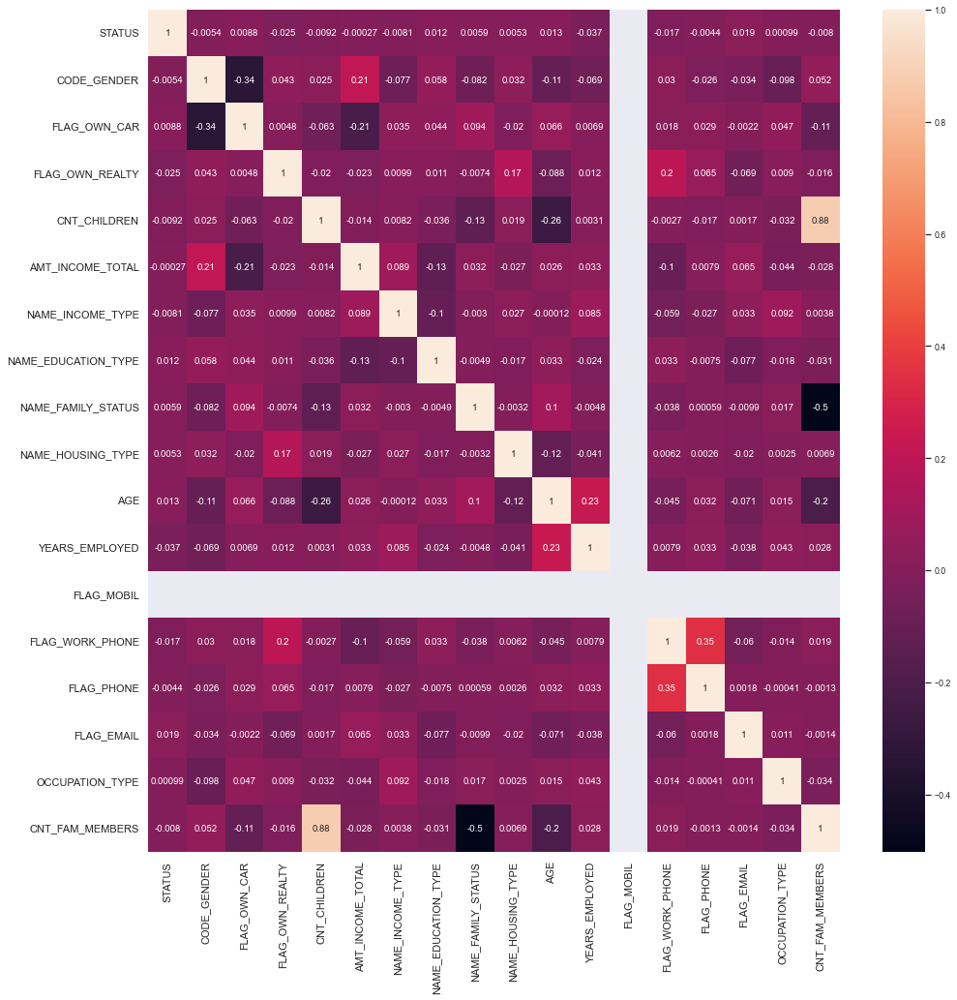

In [72]:
fig, ax = plt.subplots(figsize=(16, 16))
sns.set(font_scale=0.8)
sns.heatmap(corr_merge_record.corr(), annot=True)


#### Variables con mayor correlación con la variable dependiente

- CODE_GENDER
- FLAG_OWN_CAR
- FLAG_OWN_REALTY
- AMT_INCOME_TOTAL
- NAME_EDUCATION_TYPE
- NAME_HOUSING_TYPE
- FLAG_EMAIL


##### Conclusiones

1. Es posible apreciar que la mayor cantidad de personas que se les ha aprobado la tarjeta de crédito no poseen un vehículo personal. Junto a esto es posible verificar que el nivel educacional de las personas que se les aprobó la tarjeta fue: "Secondary / secondary special". Además que estaban casadas y poseían una casa o departamento propio.
2. Para el caso de la cantidad de hijos, la media ya la desviación estandar no nos estregan una correcta información, esto se debe a que logicamente no es posible tener un 0.5 hijos. Pero, si es posible comprobar que la mayor cantidad de personas que les otorgo una tarjeta de crédito no poseen hijos.
3. Para el caso de la desviación estandar relacionado al sueldo, se puede ver si que si existe una cercanía de los datos a esta, pero también existe una tendecia a alejarse de esta. Indicando que los datos, si tiene una tendencia a estar dispersos


In [73]:
dataFrameDecisionTree = corr_merge_record.copy()
dataFrameDecisionTree.drop(
    ["CNT_CHILDREN", "YEARS_EMPLOYED", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_MOBIL", "OCCUPATION_TYPE", "CNT_FAM_MEMBERS"], axis=1, inplace=True)

dataFrameDecisionTree.head()


,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,FLAG_EMAIL
2,0,1,0,0,112500.0,0,1,1,1,58.832877,0
3,1,0,1,0,270000.0,1,1,2,1,52.356164,1
4,0,0,1,0,270000.0,1,1,2,1,52.356164,1
5,0,0,1,0,270000.0,1,1,2,1,52.356164,1
6,0,0,1,0,270000.0,1,1,2,1,52.356164,1


In [74]:
yTarget = dataFrameDecisionTree["STATUS"].values.astype('int')
X_train, X_test, y_train, y_test = train_test_split(dataFrameDecisionTree.drop(
    ['STATUS'], axis=1), yTarget, test_size=0.33, random_state=42)

tree_model = DecisionTreeClassifier(criterion='entropy',
                                    min_samples_split=20,
                                    min_samples_leaf=5,
                                    max_depth=8,
                                    class_weight={1: 7.5})
model = tree_model.fit(X_train, y_train)


In [75]:
%pip install dtreeviz


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [76]:
from dtreeviz.trees import dtreeviz
# Una forma diferente de ver el arbol
viz = dtreeviz(tree_model, X_train, yTarget,
               target_name="target",
               feature_names=X_train.columns,
               class_names=["Aprobado", "No Aprobado"])

viz


c:\Users\Marcelo Baeza\.pyenv\pyenv-win\versions\3.9.1\lib\site-packages\sklearn\base.py:450: UserWarning:

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names



In [77]:
# Realizo una predicción
y_train_pred = tree_model.predict(X_train)  # Prediccion en Train
y_test_pred = tree_model.predict(X_test)  # Prediccion en Test


In [78]:
from sklearn.metrics import accuracy_score

# Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

# Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy)
print('% de aciertos sobre el set de evaluación:', test_accuracy)


% de aciertos sobre el set de entrenamiento: 0.27354535800122964
% de aciertos sobre el set de evaluación: 0.25522015433499773


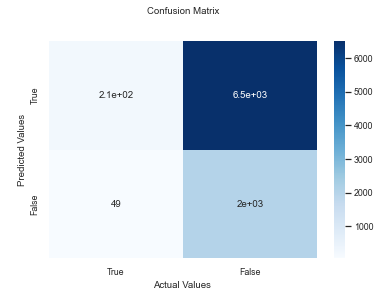

In [79]:

# X_train, X_test, y_train, y_test
confusionMatrixResult = confusion_matrix(y_test, y_test_pred)
ax = sns.heatmap(confusionMatrixResult, annot=True, cmap='Blues')

ax.set_title('Confusion Matrix\n\n')
ax.set_ylabel('\nPredicted Values')
ax.set_xlabel('Actual Values ')

# Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['True', 'False'])
ax.yaxis.set_ticklabels(['True', 'False'])

# Display the visualization of the Confusion Matrix.
plt.show()
# plt.savefig('decisionTreePLT.png', dpi=1200)


In [80]:
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()
precision = tp/(tp+fp)
recall = tp/(tp+fn)
accuracy = (tp+tn)/(tn + fp + fn + tp)
especify = tn/(tn+fp)
f1_score = 2*(recall*precision)/(recall + precision)
print(precision, recall, especify, accuracy, f1_score)


0.23875189903003388 0.9765774378585086 0.030654761904761903 0.25522015433499773 0.38369799981218894


# Creación Variables Sintéticas


In [81]:
var_corr_merge_record = corr_merge_record.copy()
var_corr_merge_record.insert(2, "AMT_INCOME_TOTAL x Family member",
                             corr_merge_record['AMT_INCOME_TOTAL']/corr_merge_record["CNT_FAM_MEMBERS"], allow_duplicates=True)
var_corr_merge_record.head()


,STATUS,CODE_GENDER,AMT_INCOME_TOTAL x Family member,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,1,56250.0,0,0,0,112500.0,0,1,1,1,58.832877,3.106849,1,0,0,0,0,2
3,1,0,270000.0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
4,0,0,270000.0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
5,0,0,270000.0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1
6,0,0,270000.0,1,0,0,270000.0,1,1,2,1,52.356164,8.358904,1,0,1,1,1,1


Variables sintéticas generadas:

- AGE.

- YEARS_EMPLOYED

- AMT_INCOME_TOTAL x Family member


---


# Comparación de Modelos de Machine Learning


In [82]:
%pip install lightgbm


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [83]:
%pip install xgboost


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [84]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from lightgbm import LGBMClassifier
# from xgboost.sklearn import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import time


## Cambiando tipo de datos


In [106]:
dataToCompareModels = corr_merge_record.copy()
dataToCompareModels["AGE"] = dataToCompareModels["AGE"].astype('int64')
dataToCompareModels["CNT_FAM_MEMBERS"] = dataToCompareModels["CNT_FAM_MEMBERS"].astype(
    'int64')
dataToCompareModels.head()


,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,1,0,0,0,112500.0,0,1,1,1,58,3.106849,1,0,0,0,0,2
3,1,0,1,0,0,270000.0,1,1,2,1,52,8.358904,1,0,1,1,1,1
4,0,0,1,0,0,270000.0,1,1,2,1,52,8.358904,1,0,1,1,1,1
5,0,0,1,0,0,270000.0,1,1,2,1,52,8.358904,1,0,1,1,1,1
6,0,0,1,0,0,270000.0,1,1,2,1,52,8.358904,1,0,1,1,1,1


## Desglozando data


In [119]:
cantiadadValores0, cantiadadValores1 = dataToCompareModels["STATUS"].value_counts(
)
X = dataToCompareModels.drop(['STATUS'], axis=1)
y = dataToCompareModels['STATUS']


## Operando con modelos


In [120]:
class Colores:
    RED = '\033[91m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    BLUE = '\033[94m'
    PINK = '\033[95m'
    TEAL = '\033[96m'
    GREY = '\033[97m'
    ENDC = '\033[0m'


### PCA


In [121]:
standarScaler = StandardScaler()
X_train = standarScaler.fit_transform(X)
numeroColumnas = len(X.columns)
# por experiencia de pruebas partir desde el 10 la suma de la variancia era lejano al 90%
# se considera mejor desde el 14, donde la variancia es superior al 95%
listadoNumeroVariables_PCA = np.arange(14, numeroColumnas, 1)


#### Cross-Validations


In [122]:
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
seed = 123

# permite obtener una relación entre el status


def obtenerPesoPorStatus():
    if cantiadadValores0 > cantiadadValores1:
        return {1: cantiadadValores0/cantiadadValores1}
    else:
        return {1: cantiadadValores1/cantiadadValores0}


# Por experiencia y prueba los modelos que tuvieron que ser borrados por que tuvieron mal performance fueron:
    # LogisticRegression
    # SVC
    # GaussianNB
    # SGDClassifier
mejoresAlgoritmos = []
for numeroPCA in listadoNumeroVariables_PCA:
    pca = PCA(n_components=numeroPCA, random_state=123)
    xTrainFit = pca.fit_transform(X_train)
    # se borra por uso de redes neuronales
    #model4 = MLPClassifier(random_state=seed, max_iter=500)
    # se quiso añadir el knn pero no se suupo considerar
    model6 = KNeighborsClassifier(weights='distance')
    model7 = DecisionTreeClassifier(
        random_state=seed, max_depth=numeroPCA, class_weight=obtenerPesoPorStatus())
    model8 = RandomForestClassifier(
        random_state=seed, class_weight="balanced", n_estimators=200, max_depth=numeroPCA)
    model9 = GradientBoostingClassifier(
        random_state=seed, max_depth=numeroPCA, learning_rate=200)
    model10 = LGBMClassifier(
        random_state=seed, num_leaves=32, n_estimators=200, max_depth=numeroPCA, class_weight="balanced")
    models = [model6, model7, model8, model9, model10]
    print(f"{Colores.BLUE}Numero de PCA {Colores.RED}{numeroPCA}. {Colores.BLUE}Pca Variancia: {Colores.RED}{pca.explained_variance_ratio_} {Colores.GREEN}Suma:{pca.explained_variance_ratio_.sum()} {Colores.ENDC}")
    for model in models:
        start_time = time.time()
        cvKfold = StratifiedKFold(n_splits=10, random_state=seed, shuffle=True)
        # trabajando como medida con curva roc
        scores = cross_val_score(
            model, xTrainFit, y, scoring='roc_auc', cv=cvKfold, n_jobs=4)
        end_time = time.time()
        print(
            f"\t - {Colores.YELLOW}Modelo {model} - {Colores.RED}{np.mean(scores)}. {Colores.YELLOW}Tiempo de ejecución {Colores.GREY}{(time.time() - start_time)} {Colores.ENDC}")
        mejoresAlgoritmos.append({
            "promedio": np.mean(scores),
            "modelo": model,
            "pca": pca,
            "xTrainFit": xTrainFit
        })
    print("-----------------------------------------------------------")


Numero de PCA 14. Pca Variancia: [0.13933237 0.09665554 0.09303316 0.08009989 0.07744163 0.06962485
 0.06072715 0.05720777 0.05454987 0.05421989 0.05112995 0.04637949
 0.0417976  0.03921658] Suma:0.9614157148825035 
	 - Modelo KNeighborsClassifier(weights='distance') - 0.6441508004826411. Tiempo de ejecución 2.8602755069732666 
	 - Modelo DecisionTreeClassifier(class_weight={1: 3.1303944315545245}, max_depth=14,
                       random_state=123) - 0.6045859214686582. Tiempo de ejecución 0.8804335594177246 
	 - Modelo RandomForestClassifier(class_weight='balanced', max_depth=14, n_estimators=200,
                       random_state=123) - 0.651808835345483. Tiempo de ejecución 29.78404188156128 
	 - Modelo GradientBoostingClassifier(learning_rate=200, max_depth=14, random_state=123) - 0.49994245645208196. Tiempo de ejecución 82.45045566558838 
	 - Modelo LGBMClassifier(class_weight='balanced', max_depth=14, n_estimators=200,
               num_leaves=32, random_state=123) - 0.649

In [123]:
modelosOrdenados = list(
    sorted(mejoresAlgoritmos, key=lambda x: x["promedio"], reverse=True))
modelosOrdenados

[{'promedio': 0.6555185408933422,
  'modelo': RandomForestClassifier(class_weight='balanced', max_depth=16, n_estimators=200,
                         random_state=123),
  'pca': PCA(n_components=16, random_state=123),
  'xTrainFit': array([[ 0.60298043, -1.39285218,  0.27285971, ...,  0.83784455,
          -0.41865772, -0.01745974],
         [ 2.2958884 , -0.55990401, -0.7675897 , ..., -0.11932678,
          -0.46034111,  0.37164504],
         [ 2.2958884 , -0.55990401, -0.7675897 , ..., -0.11932678,
          -0.46034111,  0.37164504],
         ...,
         [-1.46967897, -0.35288336, -0.66675901, ..., -1.39486508,
           0.34880091, -0.08570042],
         [-1.46967897, -0.35288336, -0.66675901, ..., -1.39486508,
           0.34880091, -0.08570042],
         [ 0.46291757, -1.47467319,  1.04584416, ...,  0.26574086,
          -0.50733643, -0.04338305]])},
 {'promedio': 0.653537704512196,
  'modelo': RandomForestClassifier(class_weight='balanced', max_depth=15, n_estimators=200,
  

In [133]:
kfold = 10
skf = StratifiedKFold(n_splits=kfold, shuffle=True, random_state=seed)

X1 = np.array(modelosOrdenados[0]['xTrainFit'])
X2 = np.array(X)
y1 = np.array(y)
# enumerate(skf.split(X1, y1))
for i, (dataOperacion1, dataOperacion2, dataOperacion3) in enumerate(zip(skf.split(X1, y1), skf.split(X2, y1), skf.split(X1, y1))):
    print(np.array_equal(dataOperacion1[1], dataOperacion2[1]))
    print(np.array_equal(dataOperacion2[1], dataOperacion3[1]))
    # print(dataOperacion2[1])
    # print(dataOperacion3[1])
    # print(dataOperacion1, dataOperacion2, dataOperacion3)


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


### Trabajando sobre los mejores promedios


1. LGBMClassifier
2. GradientBoostingClassifier
3. GaussianNB


Se genera a partir de los splits de cross validations entrenamientos y predicciones de los modelos, con el fin de obtener una comparativa y porcentaje de relación entre los algoritmos de machin learning


In [135]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

kfold = 10
skf = StratifiedKFold(n_splits=kfold, shuffle=True, random_state=seed)


def operandoMejoresModelos(modelosPromedio):

    # Valores para modelo 1
    X1 = np.array(modelosPromedio[0]['xTrainFit'])
    # Valores para modelo 2
    X2 = np.array(modelosPromedio[1]['xTrainFit'])
    # Valores para modelo 3
    X3 = np.array(modelosPromedio[2]['xTrainFit'])
    # for i, (dataOperacion1, dataOperacion2, dataOperacion3) in enumerate(zip(skf.split(X1, y1), skf.split(X2, y1), skf.split(X1, y1))):

    yGenerico = np.array(y)
    scores = []
    # for i, (train_index, test_index) in enumerate(skf.split(X1, y1)):
    for i, (dataOperacion1, dataOperacion2, dataOperacion3) in enumerate(zip(skf.split(X1, yGenerico), skf.split(X2, yGenerico), skf.split(X3, yGenerico))):
        print('[Fold %d/%d]' % (i + 1, kfold))

        X_train1, X_valid1 = X1[dataOperacion1[0]], X1[dataOperacion1[1]]
        y_train1, y_valid_generico = yGenerico[dataOperacion1[0]
                                               ], yGenerico[dataOperacion1[1]]

        modelosPromedio[0]['modelo'].fit(X_train1, y_train1)
        y_predic1 = pd.DataFrame(
            modelosPromedio[0]['modelo'].predict_proba(X_valid1))[1].values
        modelosPromedio[0]["scoresKfold"].append(y_predic1)
        nombreModelo = modelosPromedio[0]['modelo']

        # MODELO 2

        X_train2, X_valid2 = X2[dataOperacion2[0]], X2[dataOperacion2[1]]
        y_train2, y_valid_generico = yGenerico[dataOperacion2[0]
                                               ], yGenerico[dataOperacion2[1]]

        modelosPromedio[1]['modelo'].fit(X_train2, y_train2)
        y_predic2 = pd.DataFrame(
            modelosPromedio[1]['modelo'].predict_proba(X_valid2))[1].values

        # MODELO 3
        X_train3, X_valid3 = X3[dataOperacion2[0]], X3[dataOperacion2[1]]
        y_train3, y_valid_generico = yGenerico[dataOperacion2[0]
                                               ], yGenerico[dataOperacion2[1]]

        modelosPromedio[2]['modelo'].fit(X_train3, y_train3)
        y_predic3 = pd.DataFrame(
            modelosPromedio[2]['modelo'].predict_proba(X_valid3))[1].values

        y_pred = 0.60 * y_predic1 + 0.25 * y_predic2 + 0.15 * y_predic3

        score = roc_auc_score(y_valid_generico, y_pred)
        # y_pred_label = np.where(y_pred < 0.5, 0, 1)
        # print(classification_report(y_valid_generico, y_pred_label, zero_division=1))
        scores.append(score)
    print(f"Avg scores - {np.mean(scores)}")


operandoMejoresModelos(modelosOrdenados)


[Fold 1/10]
[Fold 2/10]
[Fold 3/10]
[Fold 4/10]
[Fold 5/10]
[Fold 6/10]
[Fold 7/10]
[Fold 8/10]
[Fold 9/10]
[Fold 10/10]
Avg scores - 0.6551592576206053


### Operando con los 3 modelos


Clasificación realizada para el data set completo.

Esto permite obtener la probabilidad que la se puede categorizar efectivamente.


In [138]:
x_test_1 = np.array(modelosOrdenados[0]['xTrainFit'])
x_test_2 = np.array(modelosOrdenados[1]['xTrainFit'])
x_test_3 = np.array(modelosOrdenados[2]['xTrainFit'])
y_pred_test1 = pd.DataFrame(
    modelosOrdenados[0]['modelo'].predict_proba(x_test_1))[1].values
y_pred_test2 = pd.DataFrame(
    modelosOrdenados[1]['modelo'].predict_proba(x_test_2))[1].values
y_pred_test3 = pd.DataFrame(
    modelosOrdenados[2]['modelo'].predict_proba(x_test_3))[1].values
y_pred_final = 0.65 * y_pred_test1 + 0.25 * y_pred_test2 + 0.10 * y_pred_test3


## Analizando resultados de algoritmos


In [139]:
def describeNumpy(arrayIn):

    r1 = np.mean(arrayIn)
    print("Mean: ", r1)

    r2 = np.std(arrayIn)
    print("std: ", r2)

    r3 = np.var(arrayIn)
    print("Variance: ", r3)


### Predicción para el modelo GaussianNB


In [140]:
describeNumpy(y_pred_test1)


Mean:  0.4086064517000264
std:  0.1802870050017318
Variance:  0.03250340417249447


### Predicción para el modelo GradientBoostingClassifier


In [141]:
describeNumpy(y_pred_test2)


Mean:  0.4237135502500661
std:  0.15429060051600293
Variance:  0.02380558940758881


### Predicción para el modelo LGBMClassifier


In [142]:
describeNumpy(y_pred_test3)


Mean:  0.430618788181687
std:  0.1436314765925081
Variance:  0.0206300010681442


In [143]:
# sort_values( by=["STATUS"], ascending=False)
submission = pd.DataFrame({'STATUS': y_pred_final})
submission.describe()


,STATUS
count,26703.000000
mean,0.414584
std,0.169524
min,0.023096
25%,0.284316
50%,0.412810
75%,0.539415
max,0.913033


## Conclusiones


- Es posible apreciar que en comparativa de los podemos existen 3 que resalta a la hora de efectuar una correcta categorización.

- En los 3 de los modelos existe una baja desviación estandar, permitiendo entender que no existe una gran dispersión de los datos, por lo que los modelos clasificaron de una manera uniforme, sin tanta diferencia.

- A pesar de poseer una desviación estandar el promedio de categorización es bajo. Por lo que la probablidad de etiquetar correctamente será baja

- Respecto a la probabilidad promediada de donde se presenta anteriormente, la probabilidad mínima es muy baja para considerar en un futuro, y el 75% supera el 13% lo cual sigue siendo bajo.Pero se mantiene la desviación estable.


# Bias-Variance Trade Off


En base a los datos obtenidos de los modelos del desafio anterior, ya poseemos la varianza y el bias para hacer el calculo correspondiente y saber cual es el modelo mejor ajustado.


In [97]:
# model10
var10 = 0.00685743554883403
bias10 = 0.0886623994331228
bvto10 = var10 + bias10 ** 2
bvto10


0.014718456622072645

In [98]:
# model3
var3 = 0.00012504460759358888
bias3 = 0.09531791631950973
bvto3 = var3 + bias3 ** 2
bvto3


0.009210549779086648

## Conclusiones


El modelo 3 es mejor en cuanto a presicion ya que tiene un error final significativamente menor al modelo 10.
